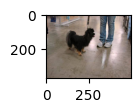

(375, 499, 3)


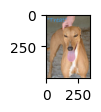

(500, 347, 3)


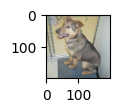

(199, 200, 3)


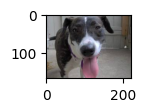

(166, 220, 3)


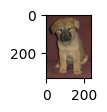

(333, 235, 3)


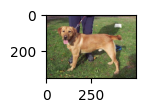

(355, 500, 3)


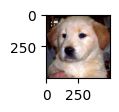

(500, 499, 3)


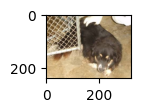

(241, 323, 3)


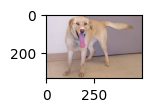

(332, 500, 3)
Found 8000 images belonging to 2 classes.
Found 2000 images belonging to 2 classes.
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 150, 150, 32)      896       
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 75, 75, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_6 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 37, 37, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_7 (Conv2D)           (None, 37, 37, 128)       73856     
                      

C:\Python311\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


250/250 [==============================] - ETA: 0s - loss: 0.6532 - accuracy: 0.6162
Epoch 2: val_loss improved from 0.66529 to 0.65619, saving model to model3_with_01.weights.best.hdf5
250/250 [==============================] - 87s 347ms/step - loss: 0.6532 - accuracy: 0.6162 - val_loss: 0.6562 - val_accuracy: 0.6055
Epoch 3/20
250/250 [==============================] - ETA: 0s - loss: 0.6030 - accuracy: 0.6704
Epoch 3: val_loss improved from 0.65619 to 0.60550, saving model to model3_with_01.weights.best.hdf5
250/250 [==============================] - 87s 348ms/step - loss: 0.6030 - accuracy: 0.6704 - val_loss: 0.6055 - val_accuracy: 0.6775
Epoch 4/20
250/250 [==============================] - ETA: 0s - loss: 0.5754 - accuracy: 0.6994
Epoch 4: val_loss improved from 0.60550 to 0.56436, saving model to model3_with_01.weights.best.hdf5
250/250 [==============================] - 89s 355ms/step - loss: 0.5754 - accuracy: 0.6994 - val_loss: 0.5644 - val_accuracy: 0.7230
Epoch 5/20
250/250

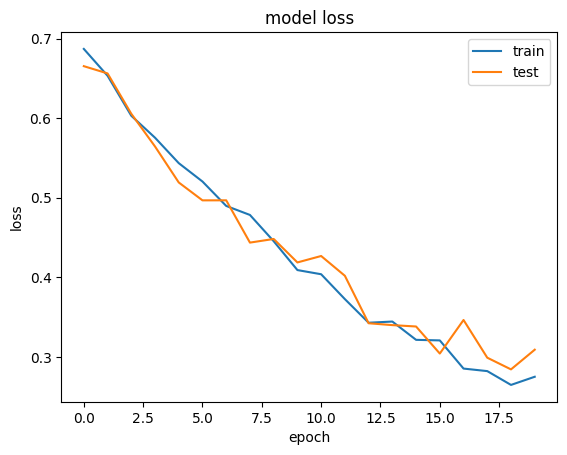

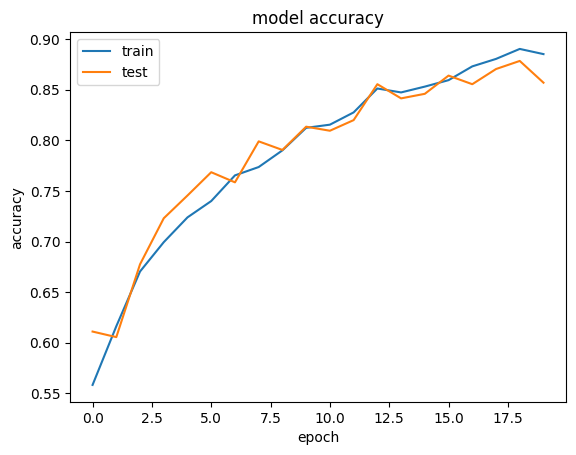

1/1 [==============================] - 0s 25ms/step


C:\Users\user\AppData\Local\Temp\ipykernel_36424\3044914924.py:154: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


1/1 [==============================] - 0s 26ms/step


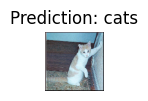

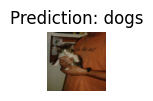

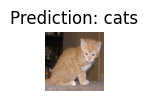

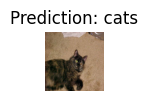

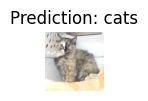

...

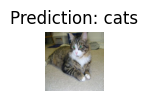

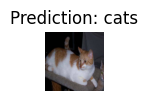

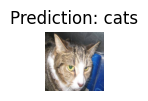

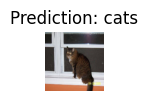

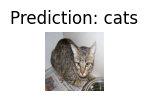

In [6]:
train_dir ="C:\\Users\\user\\Downloads\\archive\\dog vs cat\\dataset\\training_set\\"
valid_dir= "C:\\Users\\user\\Downloads\\archive\\dog vs cat\\dataset\\test_set\\"

import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.image import imread

# plot first few images
for i in range(9):
    plt.subplot(5,3,1 + i)
    filename = train_dir +"dogs\\" + 'dog.100' + str(i) + '.jpg'
    image = imread(filename)
    plt.imshow(image)
    plt.show()
    
    print(image.shape)

import pathlib
data_dir= pathlib.Path(train_dir)
class_label=np.array(sorted([item.name for item in data_dir.glob("*")]))
class_label

# create data generator -get all of the pixel values between 1 and 0   
train_datagen =tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255,
                                                               shear_range = 0.2,
                                                               zoom_range = 0.2,
                                                               horizontal_flip = True)

valid_datagen=tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255,
                                                             shear_range = 0.2,
                                                               zoom_range = 0.2,
                                                               horizontal_flip = True)


##NOTE: we also custom the other parameters

# Import data from directories and turn it into batches
train_data=train_datagen.flow_from_directory(train_dir,
                                             shuffle=True,
                                             target_size=(150,150),
                                             class_mode='binary',
                                             batch_size=32)

valid_data=valid_datagen.flow_from_directory(valid_dir,
                                             shuffle=True,
                                             target_size=(150,150),
                                             class_mode='binary',
                                             batch_size=32,
                                             )

# Get a sample of the training data batch 
images, labels = train_data.next() # get the 'next' batch of images/labels
len(images), len(labels),images.shape,labels.shape

model_01 = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32,kernel_size=(3,3), padding="same",activation="relu",kernel_initializer='he_uniform',input_shape=(150, 150, 3)),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64,(3,3),padding="same",kernel_initializer='he_uniform',activation="relu"),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(128,(3,3),padding="same",kernel_initializer='he_uniform',activation="relu"),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64,(3,3),padding="same",kernel_initializer='he_uniform',activation="relu"),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(32,(3,3),padding="same",kernel_initializer='he_uniform',activation="relu"),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1,activation="sigmoid")
    
])

#tf.keras.utils.plot_model( model_0,show_shapes=True,show_dtype=True,show_layer_names=True,dpi=96,show_layer_activations=True,)
model_01.summary()

# Create a function to implement a ModelCheckpoint callback with a specific filename 
save_model= tf.keras.callbacks.ModelCheckpoint(filepath=("model3_with_01.weights.best.hdf5"), # create filepath to save model
                                            verbose=2, # only output a limited amount of text
                                            save_best_only=True)


# Create a function to implement a Earlystop callback with loss monitor)
Early_stop=tf.keras.callbacks.EarlyStopping( monitor='val_loss',
                                             patience=10,
                                            verbose=2)
callbacks=[save_model,Early_stop]

opt=tf.keras.optimizers.experimental.SGD(learning_rate=0.01,momentum=0.9)
model_01.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

# fitting the model:
history_01=model_01.fit(train_data,
                  validation_data=valid_data,
                  validation_steps=int(len(valid_data)),
                  steps_per_epoch=int(len(train_data)),
                  batch_size=32,
                  epochs=20,
                  callbacks=[Early_stop,callbacks])

# summarize history for loss
plt.plot(history_01.history['loss'])
plt.plot(history_01.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()


# summarize history for accuracy
plt.plot(history_01.history['accuracy'])
plt.plot(history_01.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

model_01.evaluate(valid_data)

load_save_model = tf.keras.models.load_model('model3_with_01.weights.best.hdf5')
load_save_model.evaluate(valid_data)

import os
test_file="C:\\Users\\user\\Downloads\\archive\\dog vs cat\\dataset\\test_set\\cats\\"
file_names=os.listdir(test_file)

filenames=[]
for i in file_names:
    filenames.append(os.path.join(test_file,i))

# Create a function to import an image and resize it to be able to be used with our model
def load_and_prep_image(filename, img_shape=150):
    img = plt.imread(filename)
    img = tf.image.resize(img, size = [img_shape, img_shape])
    img = img/255
    return img

for i in range(len(filenames)):

    #calling global variable :"load_and_prep_image"
    image=load_and_prep_image(filename=filenames[i])

    ##expand the image dimension as the model expected shape=(None, 224, 224, 3):and we have(224, 224, 3):
    image_expanded=tf.expand_dims(image,axis=0)
    #print(f"\nShape after new dimension: {image_expanded.shape}")

    ## predicting the model:
    pred=load_save_model.predict(image_expanded)
    pred_class = class_label[int(tf.round(pred)[0][0])] # if only one output, round

  # Plot the image and predicted class

    fig = plt.figure()
    ax1 = fig.add_subplot(6,5,1+1)
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([]);
    plt.title(f"Prediction: {pred_class}")
    plt.axis(False)
    plt.tight_layout();


1/1 [==============================] - 0s 100ms/step


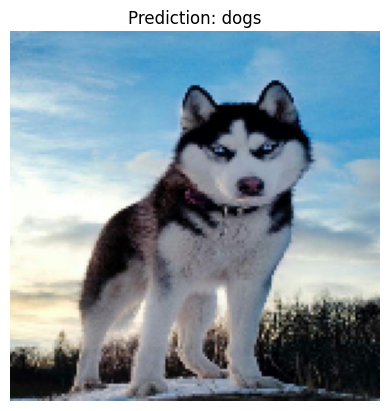

1/1 [==============================] - 0s 34ms/step


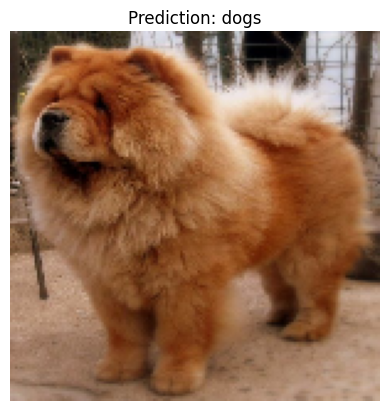

1/1 [==============================] - 0s 24ms/step


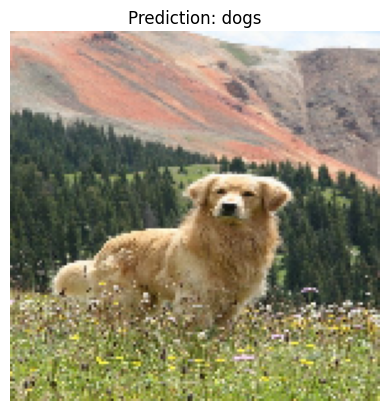

1/1 [==============================] - 0s 24ms/step


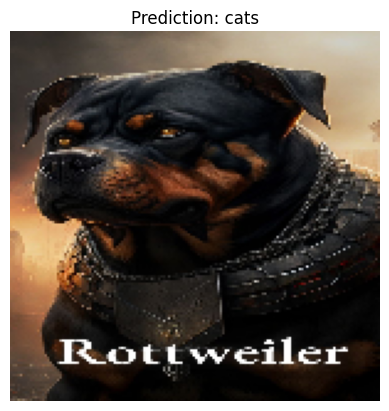

1/1 [==============================] - 0s 23ms/step


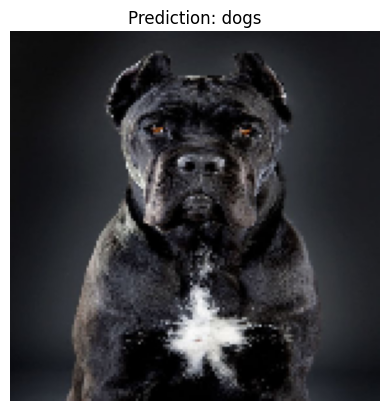

1/1 [==============================] - 0s 28ms/step


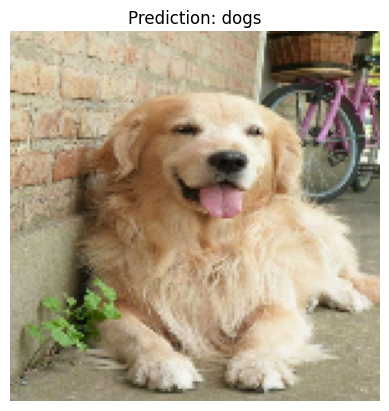

1/1 [==============================] - 0s 25ms/step


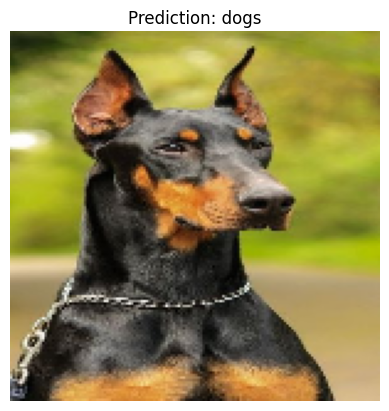

1/1 [==============================] - 0s 26ms/step


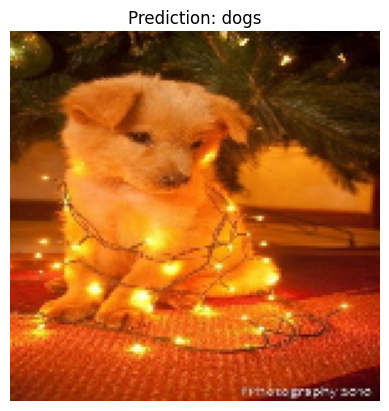

1/1 [==============================] - 0s 24ms/step


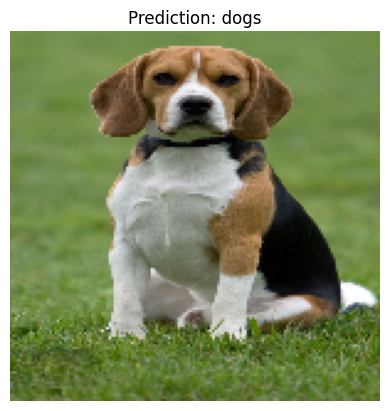

1/1 [==============================] - 0s 24ms/step


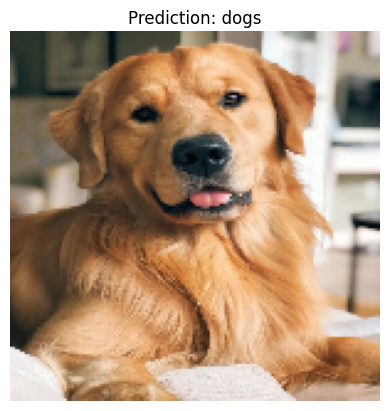

1/1 [==============================] - 0s 24ms/step


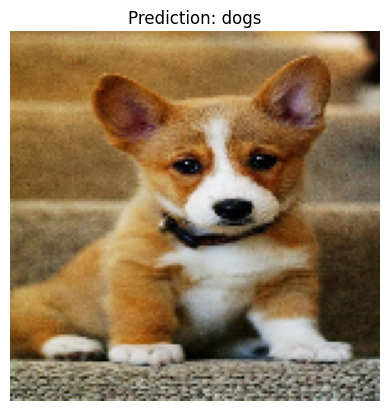

1/1 [==============================] - 0s 25ms/step


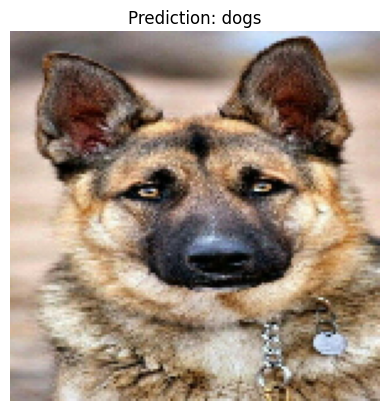

1/1 [==============================] - 0s 25ms/step


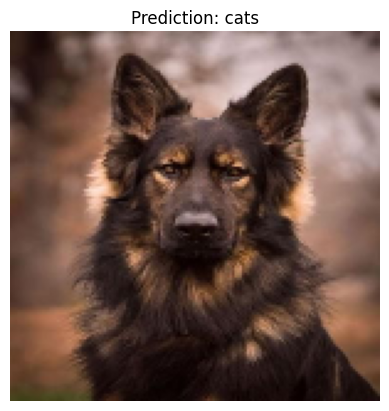

1/1 [==============================] - 0s 31ms/step


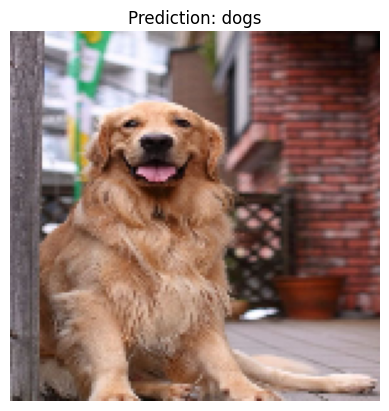

1/1 [==============================] - 0s 25ms/step


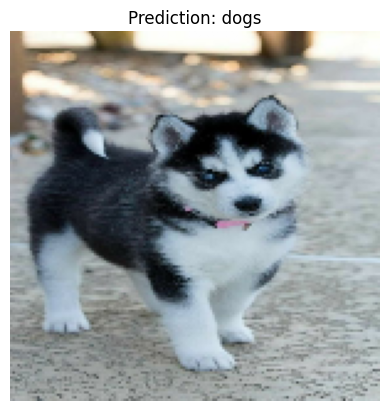

1/1 [==============================] - 0s 26ms/step


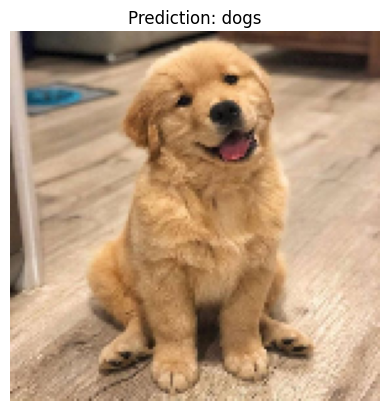

1/1 [==============================] - 0s 30ms/step


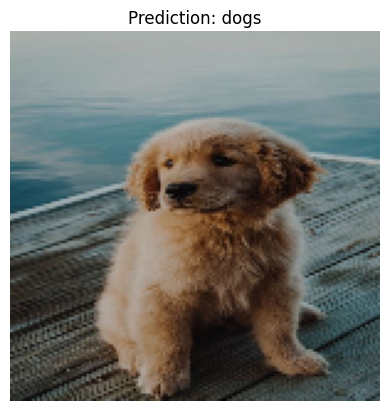

1/1 [==============================] - 0s 24ms/step


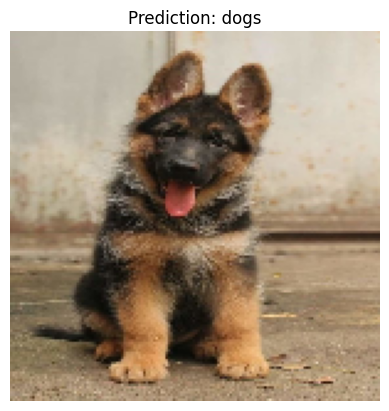

1/1 [==============================] - 0s 24ms/step


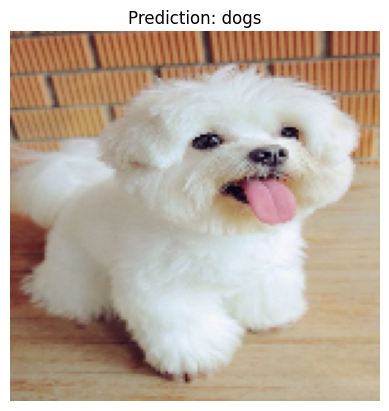

1/1 [==============================] - 0s 26ms/step


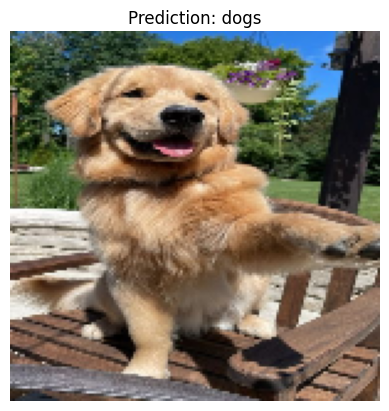

1/1 [==============================] - 0s 25ms/step


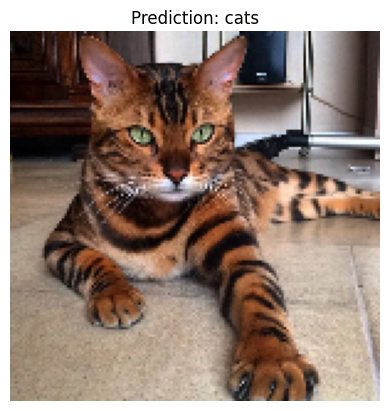

1/1 [==============================] - 0s 31ms/step


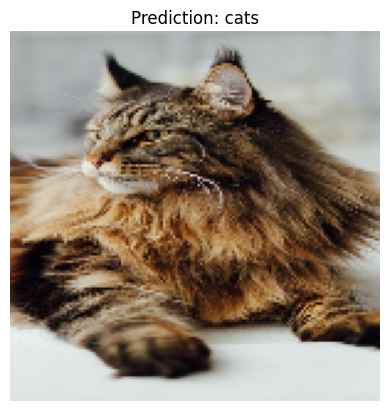

1/1 [==============================] - 0s 26ms/step


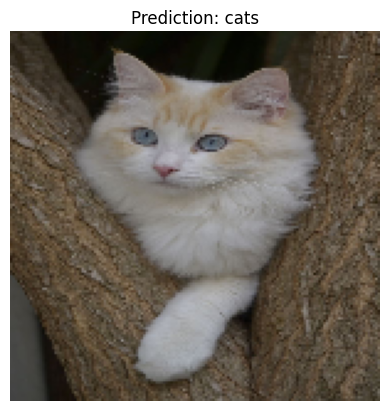

1/1 [==============================] - 0s 30ms/step


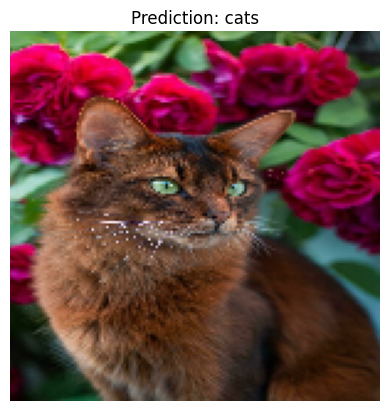

1/1 [==============================] - 0s 26ms/step


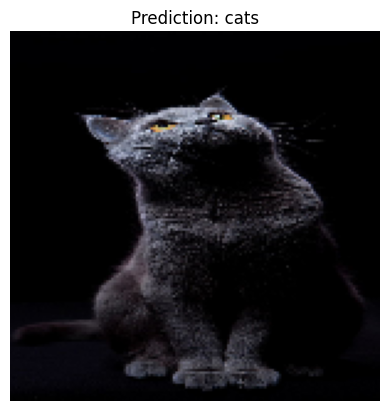

1/1 [==============================] - 0s 28ms/step


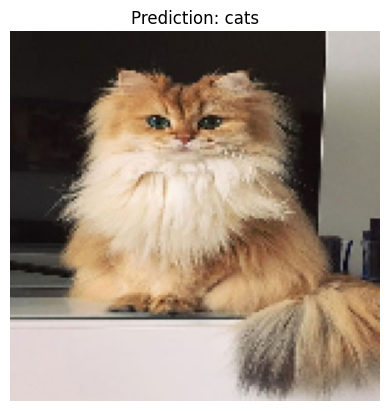

1/1 [==============================] - 0s 23ms/step


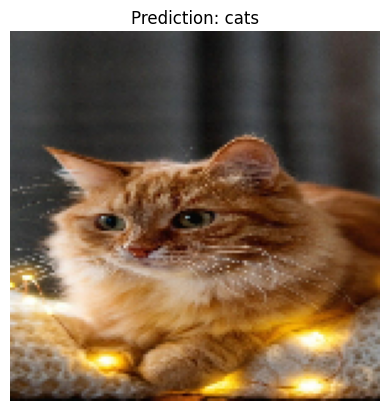

1/1 [==============================] - 0s 25ms/step


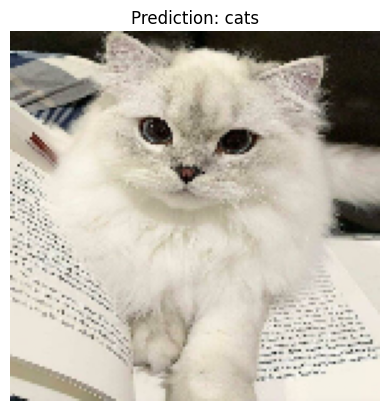

1/1 [==============================] - 0s 32ms/step


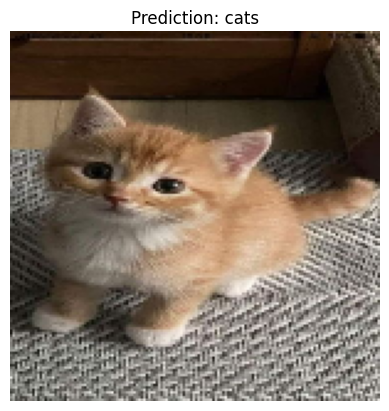

1/1 [==============================] - 0s 26ms/step


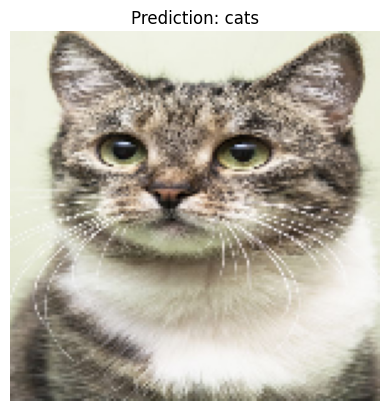

1/1 [==============================] - 0s 34ms/step


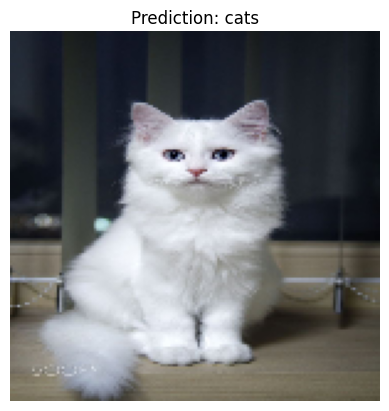

1/1 [==============================] - 0s 22ms/step


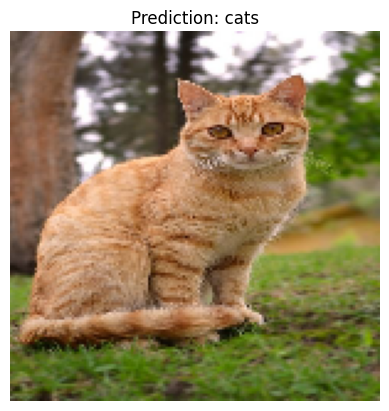

1/1 [==============================] - 0s 25ms/step


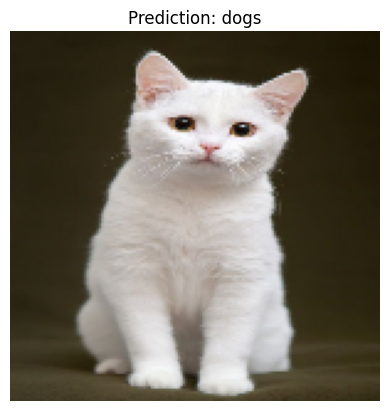

In [7]:
import tensorflow as tf
import matplotlib.pyplot as plt

# Load the saved model
load_save_model = tf.keras.models.load_model('model3_with_01.weights.best.hdf5')

# Function to load and prepare the image
def load_and_prep_image(filename, img_shape=150):
    img = plt.imread(filename)
    img = tf.image.resize(img, size=[img_shape, img_shape])
    img = img / 255
    return img

# Function to display images and predictions
def display_images_and_predictions(image_paths, model):
    for path in image_paths:
        # Load and prepare the image
        image = load_and_prep_image(path)
        image_expanded = tf.expand_dims(image, axis=0)
        
        # Predict the label
        pred = model.predict(image_expanded)
        pred_class = class_label[int(tf.round(pred)[0][0])]
        
        # Plot the image and predicted class
        plt.figure()
        plt.imshow(image)
        plt.title(f"Prediction: {pred_class}")
        plt.axis(False)
        plt.show()

# Call the function to display images and predictions
image_paths = [
    "C:\\Users\\user\\Downloads\\dc_pics\\d1.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d2.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d3.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d4.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d5.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d6.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d7.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d8.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d9.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d10.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d11.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d12.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d13.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d14.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d15.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d16.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d17.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d18.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d19.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\d20.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c1.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c2.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c3.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c4.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c5.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c6.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c7.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c8.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c9.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c10.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c11.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c12.jpeg",
    "C:\\Users\\user\\Downloads\\dc_pics\\c13.jpeg"
]

display_images_and_predictions(image_paths, load_save_model)

In [8]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# Define a function to evaluate the model
def evaluate_model(model, data_generator):
    # Predict labels
    y_pred = model.predict(data_generator)
    y_pred = np.round(y_pred).flatten()  # Convert probabilities to binary predictions
    
    # True labels
    y_true = data_generator.classes
    
    # Calculate evaluation metrics
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)
    cm = confusion_matrix(y_true, y_pred)
    
    return accuracy, precision, recall, f1, cm

# Evaluate the model on training data
train_accuracy, train_precision, train_recall, train_f1, train_cm = evaluate_model(load_save_model, train_data)

# Evaluate the model on validation data
valid_accuracy, valid_precision, valid_recall, valid_f1, valid_cm = evaluate_model(load_save_model, valid_data)

# Print evaluation metrics
print("Training Data Evaluation:")
print(f"Accuracy: {train_accuracy}")
print(f"Precision: {train_precision}")
print(f"Recall: {train_recall}")
print(f"F1 Score: {train_f1}")
print("Confusion Matrix:")
print(train_cm)

print("\nValidation Data Evaluation:")
print(f"Accuracy: {valid_accuracy}")
print(f"Precision: {valid_precision}")
print(f"Recall: {valid_recall}")
print(f"F1 Score: {valid_f1}")
print("Confusion Matrix:")
print(valid_cm)


63/63 [==============================] - 21s 329ms/step
Training Data Evaluation:
Accuracy: 0.502
Precision: 0.5022434099831744
Recall: 0.44775
F1 Score: 0.4734337827121332
Confusion Matrix:
[[2225 1775]
 [2209 1791]]

Validation Data Evaluation:
Accuracy: 0.4745
Precision: 0.47144456886898095
Recall: 0.421
F1 Score: 0.44479661912308505
Confusion Matrix:
[[528 472]
 [579 421]]
